In [221]:
import pandas as pd

In [222]:
df_conso=pd.read_csv("conso_region.csv", delimiter=';')
df_depenses=pd.read_csv("depenses_region_anah.csv")

In [223]:
# Liste des colonnes à supprimer
colonnes_a_supprimer = [
    'Superficie des logements 80 à 100 m2',
    'Superficie des logements >100 m2',
    'Résidences principales avant 1919',
    'Résidences principales de 1919 à 1945',
    'Résidences principales de 1946 à 1970',
    'Résidences principales de 1971 à 1990',
    'Résidences principales de 1991 à 2005',
    'Résidences principales de 2006 à 2015',
    'Résidences principales après 2016',
    'Taux de chauffage électrique',
    "Nombre d'habitants",
    'Taux de logements collectifs'
    'Taux de résidences principales',
    'Superficie des logements <30 m2',
    'Superficie des logements 30 à 40 m2',
    'Superficie des logements 40 à 60 m2',
    'Superficie des logements 60 à 80 m2',
    'Thermosensibilité totale (kWh DJU)',
    "Conso totale corrigée de l'aléa climatique à usages thermosensibles (MWh)",
    'Conso moyenne à usages thermosensibles (MWh)',
    'Conso moyenne à usages non thermosensibles (MWh)',
    'Thermosensibilité moyenne (kWh DJU)',
    "Conso moyenne corrigée de l'aléa climatique à usages thermosensibles (MWh)",
    'DJU à TR',
    'DJU à TN',
    'Taux de logements collectifs',
    'Taux de résidences principales',
    'Part thermosensible (%)',
    'Conso totale à usages thermosensibles (MWh)',
    'Conso totale à usages non thermosensibles (MWh)'
]

# Supprimer les colonnes
df_conso = df_conso.drop(columns=colonnes_a_supprimer, errors='ignore')

In [224]:
df_conso

,OPERATEUR,FILIERE,Année,code region,Nom Région,CODE CATEGORIE CONSOMMATION,CODE GRAND SECTEUR,CODE SECTEUR NAF2,Nb sites,Conso totale (MWh),Conso moyenne (MWh),Nombre de mailles secretisées
0,SAEML Hunelec,Electricité,2022,44,Grand Est,RES,RESIDENTIEL,NaN,3938.0,10951.006,2.780855,0
1,SAIC Pers Loisinges,Electricité,2022,84,Auvergne-Rhône-Alpes,RES,RESIDENTIEL,NaN,735.0,8445.009,11.489808,0
2,SEM Beauvois Distrelec,Electricité,2019,32,Hauts-de-France,RES,RESIDENTIEL,NaN,1041.0,4520.000,4.341979,0
3,SEM Beauvois Distrelec,Electricité,2020,32,Hauts-de-France,RES,RESIDENTIEL,NaN,953.0,3750.000,3.934942,0
4,SEM Beauvois Distrelec,Electricité,2021,32,Hauts-de-France,RES,RESIDENTIEL,NaN,949.0,3868.000,4.075869,0
...,...,...,...,...,...,...,...,...,...,...,...,...
1966,Régie municipale d'électricité de Tours en Savoie,Electricité,2011,84,Auvergne-Rhône-Alpes,RES,RESIDENTIEL,NaN,442.0,2520.000,5.000000,0
1967,Régie municipale gaz-électricité de Carmaux,Electricité,2011,76,Occitanie,RES,RESIDENTIEL,NaN,6198.0,27681.000,4.000000,0
1968,Régies municipales d'électricité de Cazeres,Electricité,2011,76,Occitanie,RES,RESIDENTIEL,NaN,2665.0,13497.000,5.000000,0
1969,RME et de télédistribution de Clouange,Electricité,2011,44,Grand Est,RES,RESIDENTIEL,NaN,2576.0,8855.000,3.000000,0


In [225]:
import pandas as pd
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer

class DropUnnecessaryColumns(BaseEstimator, TransformerMixin):
    """
    Supprime les colonnes inutiles spécifiées.
    """
    def __init__(self, columns_to_drop=None):
        self.columns_to_drop = columns_to_drop

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        if self.columns_to_drop:
            return X.drop(columns=self.columns_to_drop, errors='ignore')
        return X

class HandleMissingValues(BaseEstimator, TransformerMixin):
    """
    Gère les valeurs manquantes en utilisant un imputer.
    """
    def __init__(self, strategy='mean'):
        self.strategy = strategy
        self.imputer = SimpleImputer(strategy=self.strategy)

    def fit(self, X, y=None):
        self.imputer.fit(X)
        return self

    def transform(self, X):
        return pd.DataFrame(self.imputer.transform(X), columns=X.columns, index=X.index)

class RemoveOutliers(BaseEstimator, TransformerMixin):
    """
    Supprime les valeurs aberrantes en utilisant une règle basée sur l'IQR.
    """
    def __init__(self, threshold=1.5):
        self.threshold = threshold

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        # Calculer les limites des valeurs acceptables pour chaque colonne
        Q1 = X.quantile(0.25)
        Q3 = X.quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - self.threshold * IQR
        upper_bound = Q3 + self.threshold * IQR

        # Filtrer les lignes qui sont dans les limites
        mask = ~((X < lower_bound) | (X > upper_bound)).any(axis=1)
        return X[mask]

class StandardizeColumns(BaseEstimator, TransformerMixin):
    """
    Standardise les noms des colonnes (par ex. supprime les espaces, met en minuscule).
    """
    def fit(self, X, y=None):
        return self

    def transform(self, X):
        X.columns = [col.strip().lower().replace(' ', '_') for col in X.columns]
        return X

# Exemple de pipeline
def create_cleaning_pipeline(columns_to_drop=None, missing_value_strategy='mean', outlier_threshold=1.5):
    return Pipeline([
        ('standardize_columns', StandardizeColumns()),  # Standardise les noms de colonnes
        ('drop_unnecessary', DropUnnecessaryColumns(columns_to_drop=columns_to_drop)),  # Supprime les colonnes inutiles
        ('handle_missing', HandleMissingValues(strategy=missing_value_strategy)),  # Gère les valeurs manquantes
        ('remove_outliers', RemoveOutliers(threshold=outlier_threshold))  # Supprime les valeurs aberrantes
    ])

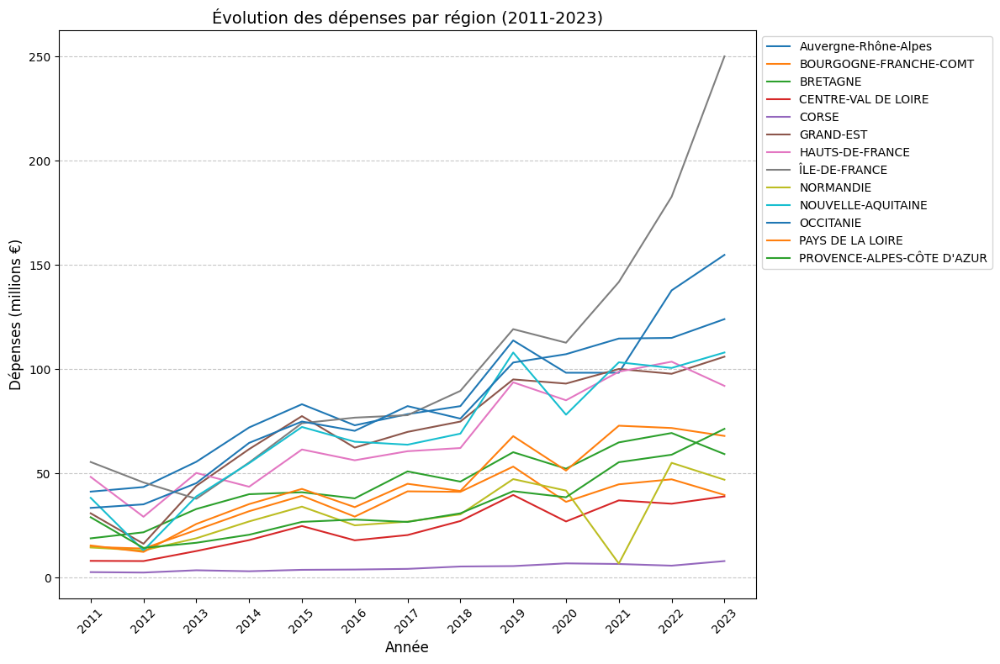

In [226]:
import matplotlib.pyplot as plt

# Supprimer la ligne "TOTAL" du DataFrame si elle est présente
df_filtered = df_depenses[df_depenses["Nom de la Region"] != "TOTAL"]

# Liste des colonnes représentant les années
years = [f"depenses {year}" for year in range(2011, 2024)]

# Transposer les données pour faciliter le traçage
expense_data = df_filtered.set_index("Nom de la Region")[years].T
expense_data.index = [int(year.split()[-1]) for year in expense_data.index]  # Convertir les années en entiers

# Création du graphique
plt.figure(figsize=(12, 8))
for region in expense_data.columns:
    line, = plt.plot(expense_data.index, expense_data[region], label=region)  # Stocke la ligne tracée

# Ajout de la légende avec les couleurs des lignes
legend_labels = [
    f"{region}" for region in expense_data.columns
]
plt.legend(
    handles=plt.gca().lines,
    labels=legend_labels,
    loc="upper left",
    bbox_to_anchor=(1, 1),
    fontsize=10
)

plt.title("Évolution des dépenses par région (2011-2023)", fontsize=14)
plt.xlabel("Année", fontsize=12)
plt.ylabel("Dépenses (millions €)", fontsize=12)
plt.xticks(expense_data.index, rotation=45)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.tight_layout()
plt.show()


In [227]:
df_conso.head()

,OPERATEUR,FILIERE,Année,code region,Nom Région,CODE CATEGORIE CONSOMMATION,CODE GRAND SECTEUR,CODE SECTEUR NAF2,Nb sites,Conso totale (MWh),Conso moyenne (MWh),Nombre de mailles secretisées
0,SAEML Hunelec,Electricité,2022,44,Grand Est,RES,RESIDENTIEL,NaN,3938.0,10951.006,2.780855,0
1,SAIC Pers Loisinges,Electricité,2022,84,Auvergne-Rhône-Alpes,RES,RESIDENTIEL,NaN,735.0,8445.009,11.489808,0
2,SEM Beauvois Distrelec,Electricité,2019,32,Hauts-de-France,RES,RESIDENTIEL,NaN,1041.0,4520.000,4.341979,0
3,SEM Beauvois Distrelec,Electricité,2020,32,Hauts-de-France,RES,RESIDENTIEL,NaN,953.0,3750.000,3.934942,0
4,SEM Beauvois Distrelec,Electricité,2021,32,Hauts-de-France,RES,RESIDENTIEL,NaN,949.0,3868.000,4.075869,0


In [228]:
df_depenses.head()

,code region,Nom de la Region,depenses 2023,nombre travaux 2023,depenses 2022,nombre travaux 2022,depenses 2021,depenses 2020,depenses 2019,depenses 2018,depenses 2017,depenses 2016,depenses 2015,depenses 2014,depenses 2013,depenses 2012,depenses 2011
0,84.0,Auvergne-Rhône-Alpes,154.8,16021,137.8,114.4,98.3,98.3,113.8,82.3,78.45,73.10,83.2,72.06,55.61,43.5,41.3
1,27.0,BOURGOGNE-FRANCHE-COMT,39.7,3824,47.2,4284.0,44.8,36.4,53.3,41.2,41.43,29.32,39.3,31.91,22.90,14.0,14.8
2,53.0,BRETAGNE,59.3,5304,69.4,6736.0,64.9,52.3,60.2,46.1,51.00,38.07,41.0,40.06,32.97,21.8,18.9
3,24.0,CENTRE-VAL DE LOIRE,39.0,4300,35.5,4238.0,37.1,27.0,39.7,27.2,20.48,17.95,24.8,18.05,12.81,8.0,8.1
4,94.0,CORSE,8.0,500,5.8,402.0,6.6,6.9,5.6,5.4,4.26,3.94,3.8,3.12,3.59,2.5,2.7


Vérification des données source:
Shape df_depenses: (14, 17)
Shape df_conso: (1971, 12)
   code region        Nom de la Region  Année  Dépenses
0         84.0    Auvergne-Rhône-Alpes   2011      41.3
1         27.0  BOURGOGNE-FRANCHE-COMT   2011      14.8
2         53.0                BRETAGNE   2011      18.9
3         24.0     CENTRE-VAL DE LOIRE   2011       8.1
4         94.0                   CORSE   2011       2.7
   code region  Année  Conso totale (MWh)
0            1   2017          723830.000
1            1   2018          688474.260
2            1   2019          678205.639
3            1   2020          722439.105
4            1   2021          703895.563

Années communes: [2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023]
Nombre d'observations après fusion: 163

Premières lignes:
  code region        Nom de la Region  Année  Dépenses  Conso totale (MWh)
0          84    Auvergne-Rhône-Alpes   2011      41.3        4.298934e+07
1          27  BOU

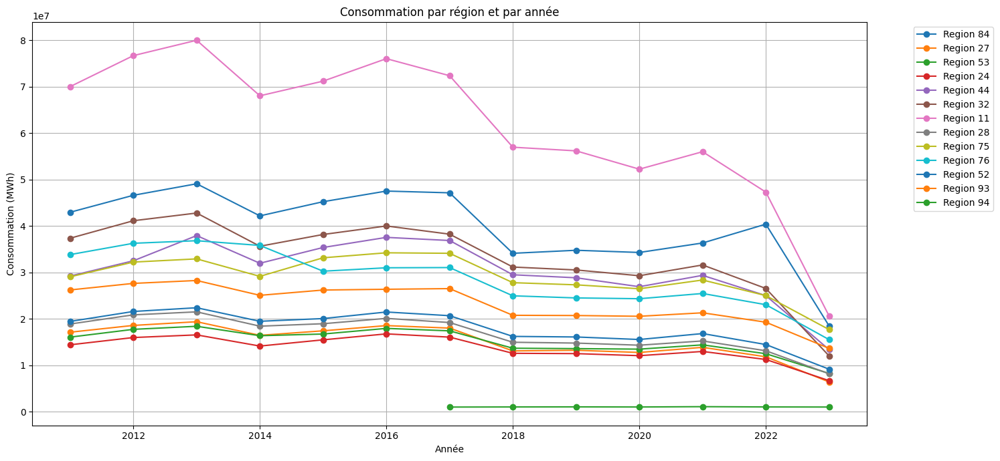


Statistiques de la fusion:
Nombre total d'observations: 163

Résumé des données:
             Année    Dépenses  Conso totale (MWh)
count   163.000000  163.000000        1.630000e+02
mean   2017.128834   55.638834        2.600578e+07
std       3.745198   37.017771        1.547339e+07
min    2011.000000    4.260000        1.024451e+06
25%    2014.000000   29.285000        1.579057e+07
50%    2017.000000   47.000000        2.153260e+07
75%    2020.000000   74.500000        3.352328e+07
max    2023.000000  250.000000        8.002754e+07

Statistiques par région:
            Conso totale (MWh)              Dépenses       
                          mean          std     mean    std
code region                                                
11                 61850162.47  16196166.84   101.47  60.68
24                 13677190.12   2784284.20    24.28  11.23
27                 15157896.45   3683118.69    35.10  12.04
28                 16837297.62   3773174.54    29.85  14.73
32           

In [229]:
import pandas as pd
import matplotlib.pyplot as plt

# Load data
# df_depenses =
# df_conso = pd.read_csv('CONSO_REGION.CSV', sep=';')

# Vérification des données chargées
print("Vérification des données source:")
print("Shape df_depenses:", df_depenses.shape)
print("Shape df_conso:", df_conso.shape)

# Prepare expenses data
years = [str(year) for year in range(2011, 2024)]
expense_cols = [f"depenses {year}" for year in years]
df_depenses_melted = df_depenses.melt(
    id_vars=['code region', 'Nom de la Region'],
    value_vars=expense_cols,
    var_name='Année',
    value_name='Dépenses'
)
df_depenses_melted['Année'] = df_depenses_melted['Année'].str.extract('(\d+)').astype(int)

# print('1')
print(df_depenses_melted.head())
# print('test')

# Group consumption data
df_conso_grouped = df_conso.groupby(['code region', 'Année'])['Conso totale (MWh)'].sum().reset_index()

# print('2')
print(df_conso_grouped.head())

# Ensure consistent types for merging
df_depenses_melted['code region'] = df_depenses_melted['code region'].astype(str)
df_conso_grouped['code region'] = df_conso_grouped['code region'].astype(str)

# 1. Nettoyer les codes régions
def clean_region_codes(df, col='code region'):
    df[col] = df[col].astype(str)
    df[col] = df[col].str.replace('.0', '')
    df[col] = df[col].str.strip()
    return df[df[col].notna() & (df[col] != 'nan')]

# Clean both dataframes
df_depenses_clean = clean_region_codes(df_depenses_melted)
df_conso_clean = clean_region_codes(df_conso_grouped)

# Ajout de vérification des années communes
annees_communes = set(df_depenses_clean['Année']).intersection(set(df_conso_clean['Année']))
print("\nAnnées communes:", sorted(annees_communes))

# Merge cleaned dataframes
df_merged = pd.merge(
    df_depenses_clean,
    df_conso_clean,
    on=['code region', 'Année'],
    how='inner'
)

# Verify merge results
print("Nombre d'observations après fusion:", len(df_merged))
print("\nPremières lignes:")
print(df_merged.head())

# Amélioration de la visualisation
plt.figure(figsize=(15, 7))
for region in df_merged['code region'].unique():
    data = df_merged[df_merged['code region'] == region]
    plt.plot(data['Année'], data['Conso totale (MWh)'],
             label=f'Region {region}', marker='o')

plt.title('Consommation par région et par année')
plt.xlabel('Année')
plt.ylabel('Consommation (MWh)')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.tight_layout()
plt.show()

# Print some statistics
print("\nStatistiques de la fusion:")
print(f"Nombre total d'observations: {len(df_merged)}")
print("\nRésumé des données:")
print(df_merged.describe())

# Ajout d'analyses statistiques pertinentes
print("\nStatistiques par région:")
print(df_merged.groupby('code region').agg({
    'Conso totale (MWh)': ['mean', 'std'],
    'Dépenses': ['mean', 'std']
}).round(2))


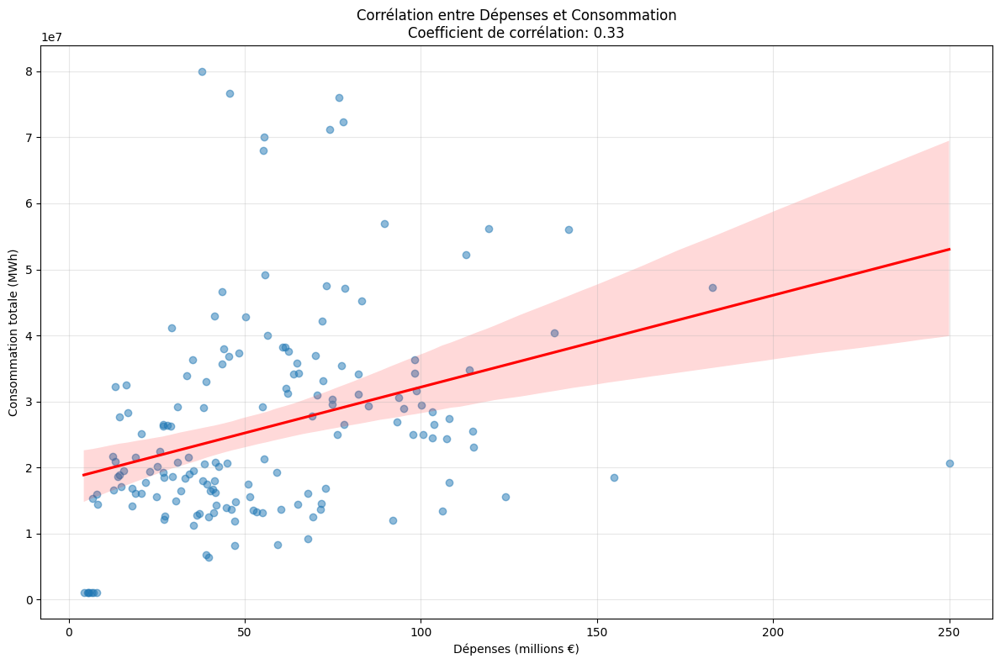


Statistiques par région:
                           Dépenses        Conso totale (MWh)             
                               mean    std               mean          std
Nom de la Region                                                          
Auvergne-Rhône-Alpes          87.12  33.72        39961578.81   8394531.78
BOURGOGNE-FRANCHE-COMT        35.10  12.04        15157896.45   3683118.69
BRETAGNE                      45.85  15.71        15143657.29   2854000.11
CENTRE-VAL DE LOIRE           24.28  11.23        13677190.12   2784284.20
CORSE                          6.08   1.21         1053044.16     28118.23
GRAND-EST                     71.52  27.99        30367439.83   6569999.12
HAUTS-DE-FRANCE               68.11  23.82        33449418.10   8143553.45
NORMANDIE                     29.85  14.73        16837297.62   3773174.54
NOUVELLE-AQUITAINE            70.30  29.58        29066218.83   4575527.89
OCCITANIE                     80.52  30.80        28712611.70   6325675.98

In [230]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats

# 1. Charger les données
# df_depenses = pd.read_csv('DEPENSES_REGION_ANAH.CSV')
# df_conso = pd.read_csv('CONSO_REGION.CSV', sep=';')

# 2. Préparer les données de dépenses
years = [str(year) for year in range(2011, 2024)]
expense_cols = [f"depenses {year}" for year in years]
df_depenses_melted = df_depenses.melt(
    id_vars=['code region', 'Nom de la Region'],
    value_vars=expense_cols,
    var_name='Année',
    value_name='Dépenses'
)
df_depenses_melted['Année'] = df_depenses_melted['Année'].str.extract('(\d+)').astype(int)

# 3. Préparer les données de consommation
df_conso_grouped = df_conso.groupby(['code region', 'Année'])['Conso totale (MWh)'].sum().reset_index()

# 4. Nettoyer et fusionner
def clean_region_codes(df):
    df['code region'] = df['code region'].astype(str).str.replace('.0', '')
    return df[df['code region'].notna() & (df['code region'] != 'nan')]

df_depenses_clean = clean_region_codes(df_depenses_melted)
df_conso_clean = clean_region_codes(df_conso_grouped)

df_merged = pd.merge(
    df_depenses_clean,
    df_conso_clean,
    on=['code region', 'Année'],
    how='inner'
)

# 5. Calculer la corrélation
correlation = df_merged['Dépenses'].corr(df_merged['Conso totale (MWh)'])

# 6. Visualisations
plt.figure(figsize=(12, 8))

# Scatter plot avec ligne de régression
sns.regplot(data=df_merged,
            x='Dépenses',
            y='Conso totale (MWh)',
            scatter_kws={'alpha':0.5},
            line_kws={'color': 'red'})

plt.title(f'Corrélation entre Dépenses et Consommation\nCoefficient de corrélation: {correlation:.2f}')
plt.xlabel('Dépenses (millions €)')
plt.ylabel('Consommation totale (MWh)')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# 7. Statistiques par région
stats_by_region = df_merged.groupby('Nom de la Region').agg({
    'Dépenses': ['mean', 'std'],
    'Conso totale (MWh)': ['mean', 'std']
}).round(2)

print("\nStatistiques par région:")
print(stats_by_region)

In [231]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Charger les données
# df_depenses = pd.read_csv('DEPENSES_REGION_ANAH.CSV')
# df_conso = pd.read_csv('CONSO_REGION.CSV', sep=';')

# Préparer les données de dépenses
years = [str(year) for year in range(2011, 2024)]
expense_cols = [f"depenses {year}" for year in years]
df_depenses_melted = df_depenses.melt(
    id_vars=['code region', 'Nom de la Region'],
    value_vars=expense_cols,
    var_name='Année',
    value_name='Dépenses'
)
df_depenses_melted['Année'] = df_depenses_melted['Année'].str.extract('(\d+)').astype(int)

# Préparer les données de consommation
df_conso_grouped = df_conso.groupby(['code region', 'Année'])['Conso totale (MWh)'].sum().reset_index()

# Nettoyer et fusionner
def clean_region_codes(df):
    df['code region'] = df['code region'].astype(str).str.replace('.0', '')
    return df[df['code region'].notna() & (df['code region'] != 'nan')]

df_depenses_clean = clean_region_codes(df_depenses_melted)
df_conso_clean = clean_region_codes(df_conso_grouped)

df_merged = pd.merge(
    df_depenses_clean,
    df_conso_clean,
    on=['code region', 'Année'],
    how='inner'
)

# Créer le graphique
fig = make_subplots(specs=[[{"secondary_y": True}]])
# Créer des traces pour chaque région
for region in df_merged['Nom de la Region'].unique():
    df_region = df_merged[df_merged['Nom de la Region'] == region]

    # Trace des dépenses
    fig.add_trace(
        go.Scatter(
            x=df_region['Année'],
            y=df_region['Dépenses'],
            name=f"{region} - Dépenses",
            mode='lines+markers',
            line=dict(dash='solid')
        ),
        secondary_y=False
    )

    # Trace de la consommation
    fig.add_trace(
        go.Scatter(
            x=df_region['Année'],
            y=df_region['Conso totale (MWh)'],
            name=f"{region} - Consommation",
            mode='lines+markers',
            line=dict(dash='dot')
        ),
        secondary_y=True
    )

# Mise à jour du layout
fig.update_layout(
    title="Évolution des Dépenses de Rénovation et de la Consommation par Région",
    xaxis_title="Année",
    hovermode="x unified",
    height=800,
    showlegend=True,
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="left",
        x=1.05
    )
)

# Mise à jour des axes y
fig.update_yaxes(title_text="Dépenses (millions €)", secondary_y=False)
fig.update_yaxes(title_text="Consommation (MWh)", secondary_y=True)

# Afficher le graphique
fig.show()

In [232]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Charger les données
# df_depenses = pd.read_csv('DEPENSES_REGION_ANAH.CSV')
# df_conso = pd.read_csv('CONSO_REGION.CSV', sep=';')

# Préparer les données de dépenses
years = [str(year) for year in range(2011, 2024)]
expense_cols = [f"depenses {year}" for year in years]
df_depenses_melted = df_depenses.melt(
    id_vars=['code region', 'Nom de la Region'],
    value_vars=expense_cols,
    var_name='Année',
    value_name='Dépenses'
)
df_depenses_melted['Année'] = df_depenses_melted['Année'].str.extract('(\d+)').astype(int)

# Préparer les données de consommation
df_conso_grouped = df_conso.groupby(['code region', 'Année'])['Conso totale (MWh)'].sum().reset_index()

# Nettoyer et fusionner
def clean_region_codes(df):
    df['code region'] = df['code region'].astype(str).str.replace('.0', '')
    return df[df['code region'].notna() & (df['code region'] != 'nan')]

df_depenses_clean = clean_region_codes(df_depenses_melted)
df_conso_clean = clean_region_codes(df_conso_grouped)

df_merged = pd.merge(
    df_depenses_clean,
    df_conso_clean,
    on=['code region', 'Année'],
    how='inner'
)
# Sélectionner les régions avec les plus grandes variations
top_regions = df_merged.groupby('Nom de la Region')['Dépenses'].agg(['mean', 'std']).sort_values('mean', ascending=False).head(5).index

# Créer le graphique avec dropdown pour sélection des régions
fig = make_subplots(specs=[[{"secondary_y": True}]])

colors = px.colors.qualitative.Set3  # Palette de couleurs harmonieuse

for idx, region in enumerate(top_regions):
    df_region = df_merged[df_merged['Nom de la Region'] == region]

    fig.add_trace(
        go.Scatter(
            x=df_region['Année'],
            y=df_region['Dépenses'],
            name=f"{region} - Dépenses",
            mode='lines+markers',
            line=dict(color=colors[idx], width=2),
            marker=dict(size=8)
        ),
        secondary_y=False
    )

    fig.add_trace(
        go.Scatter(
            x=df_region['Année'],
            y=df_region['Conso totale (MWh)'],
            name=f"{region} - Consommation",
            mode='lines+markers',
            line=dict(color=colors[idx], dash='dot', width=2),
            marker=dict(size=8)
        ),
        secondary_y=True
    )

fig.update_layout(
    title="Top 5 Régions : Évolution des Dépenses et Consommation",
    xaxis_title="Année",
    hovermode="x unified",
    height=600,
    showlegend=True,
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="left",
        x=1.05
    ),
    updatemenus=[{
        'buttons': [
            {'label': 'Tous',
             'method': 'update',
             'args': [{'visible': [True] * len(top_regions) * 2}]},
            *[{'label': region,
               'method': 'update',
               'args': [{'visible': [i//2 == j for i in range(len(top_regions)*2)]}]}
              for j, region in enumerate(top_regions)]
        ],
        'direction': 'down',
        'showactive': True,
    }]
)

fig.update_yaxes(title_text="Dépenses (millions €)", secondary_y=False)
fig.update_yaxes(title_text="Consommation (MWh)", secondary_y=True)

fig.show()

In [233]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px

# Charger les données
# df_depenses = pd.read_csv('DEPENSES_REGION_ANAH.CSV')
# df_conso = pd.read_csv('CONSO_REGION.CSV', sep=';')

# Préparer les données de dépenses
years = [str(year) for year in range(2011, 2024)]
expense_cols = [f"depenses {year}" for year in years]
df_depenses_melted = df_depenses.melt(
    id_vars=['code region', 'Nom de la Region'],
    value_vars=expense_cols,
    var_name='Année',
    value_name='Dépenses'
)
df_depenses_melted['Année'] = df_depenses_melted['Année'].str.extract('(\d+)').astype(int)

# Préparer les données de consommation
df_conso_grouped = df_conso.groupby(['code region', 'Année'])['Conso totale (MWh)'].sum().reset_index()

# Nettoyer et fusionner
def clean_region_codes(df):
    df['code region'] = df['code region'].astype(str).str.replace('.0', '')
    return df[df['code region'].notna() & (df['code region'] != 'nan')]

df_depenses_clean = clean_region_codes(df_depenses_melted)
df_conso_clean = clean_region_codes(df_conso_grouped)

df_merged = pd.merge(
    df_depenses_clean,
    df_conso_clean,
    on=['code region', 'Année'],
    how='inner'
)

# Créer une palette de couleurs unique pour chaque région
n_regions = len(df_merged['Nom de la Region'].unique())
colors = px.colors.qualitative.Set3 + px.colors.qualitative.Pastel + px.colors.qualitative.Safe

fig = make_subplots(specs=[[{"secondary_y": True}]])

# Ajouter toutes les régions
for idx, region in enumerate(sorted(df_merged['Nom de la Region'].unique())):
    if region != 'TOTAL':  # Exclure le total
        df_region = df_merged[df_merged['Nom de la Region'] == region]

        fig.add_trace(
            go.Scatter(
                x=df_region['Année'],
                y=df_region['Dépenses'],
                name=f"{region} - Dépenses",
                mode='lines+markers',
                line=dict(color=colors[idx], width=2),
                marker=dict(size=8)
            ),
            secondary_y=False
        )

        fig.add_trace(
            go.Scatter(
                x=df_region['Année'],
                y=df_region['Conso totale (MWh)'],
                name=f"{region} - Consommation",
                mode='lines+markers',
                line=dict(color=colors[idx], dash='dot', width=2),
                marker=dict(size=8)
            ),
            secondary_y=True
        )

# Mise à jour du layout avec titre en bas
fig.update_layout(
    title=None,  # Supprime le titre du haut
    xaxis_title="Année",
    hovermode="x unified",
    height=800,
    showlegend=True,
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="left",
        x=1.05
    ),
    annotations=[
        dict(
            text="Évolution des Dépenses et Consommation par Région",
            xref="paper",
            yref="paper",
            x=0.5,
            y=-0.15,  # Position sous le graphique
            showarrow=False,
            font=dict(size=16)
        )
    ],
    margin=dict(b=100),  # Ajoute de l'espace en bas pour le titre
    updatemenus=[{
        'buttons': [
            {'label': 'Toutes les régions',
             'method': 'update',
             'args': [{'visible': [True] * len(df_merged['Nom de la Region'].unique()) * 2}]},
            *[{'label': region,
               'method': 'update',
               'args': [{'visible': [i//2 == j for i in range(len(df_merged['Nom de la Region'].unique())*2)]}]}
              for j, region in enumerate(sorted(df_merged['Nom de la Region'].unique())) if region != 'TOTAL']
        ],
        'direction': 'down',
        'showactive': True,
        'x': 0.1,
        'y': 1.1,
        'xanchor': 'left',
        'yanchor': 'top'
    }]
)

fig.update_yaxes(title_text="Dépenses (millions €)", secondary_y=False)
fig.update_yaxes(title_text="Consommation (MWh)", secondary_y=True)

fig.show()

In [234]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# 1. Carte de chaleur des dépenses par région et année
def plot_heatmap(df_merged):
    pivot_data = df_merged.pivot(
        index='Nom de la Region',
        columns='Année',
        values='Dépenses'
    )
    fig = px.imshow(pivot_data,
                    title="Carte de chaleur des dépenses par région",
                    labels=dict(x="Année", y="Région", color="Dépenses (M€)"))
    fig.show()

# 2. Ratio efficacité (Variation consommation / Dépenses cumulées)
def plot_efficiency_ratio(df_merged):
    df_efficiency = df_merged.groupby('Nom de la Region').agg({
        'Dépenses': 'sum',
        'Conso totale (MWh)': lambda x: (x.iloc[-1] - x.iloc[0]) / x.iloc[0] * 100
    }).reset_index()

    fig = px.scatter(df_efficiency,
                     x='Dépenses',
                     y='Conso totale (MWh)',
                     text='Nom de la Region',
                     title="Efficacité des investissements par région")
    fig.show()

# 3. Évolution du ratio dépenses/consommation
def plot_spending_consumption_ratio(df_merged):
    df_merged['Ratio'] = df_merged['Dépenses'] / df_merged['Conso totale (MWh)']

    fig = px.line(df_merged,
                  x='Année',
                  y='Ratio',
                  color='Nom de la Region',
                  title="Évolution du ratio dépenses/consommation")
    fig.show()

# 4. Boxplot des dépenses par région
def plot_spending_distribution(df_merged):
    fig = px.box(df_merged,
                 x='Nom de la Region',
                 y='Dépenses',
                 title="Distribution des dépenses par région")
    fig.update_xaxes(tickangle=45)
    fig.show()

# Appeler les fonctions
plot_heatmap(df_merged)
plot_efficiency_ratio(df_merged)
plot_spending_consumption_ratio(df_merged)
plot_spending_distribution(df_merged)

In [235]:
import plotly.express as px

# 1. Carte des dépenses par région
def plot_expenses_map(df_merged):
    df_latest = df_merged[df_merged['Année'] == df_merged['Année'].max()]
    fig = px.choropleth(df_latest,
                        geojson="https://raw.githubusercontent.com/gregoiredavid/france-geojson/master/regions-version-simplifiee.geojson",
                        locations='code region',
                        featureidkey="properties.code",
                        color='Dépenses',
                        hover_name='Nom de la Region',
                        color_continuous_scale="Viridis",
                        title="Dépenses par région (dernière année)")
    fig.update_geos(fitbounds="locations", visible=False)
    fig.show()

# 2. Carte de la consommation par région
def plot_consumption_map(df_merged):
    df_latest = df_merged[df_merged['Année'] == df_merged['Année'].max()]
    fig = px.choropleth(df_latest,
                        geojson="https://raw.githubusercontent.com/gregoiredavid/france-geojson/master/regions-version-simplifiee.geojson",
                        locations='code region',
                        featureidkey="properties.code",
                        color='Conso totale (MWh)',
                        hover_name='Nom de la Region',
                        color_continuous_scale="Viridis",
                        title="Consommation par région (dernière année)")
    fig.update_geos(fitbounds="locations", visible=False)
    fig.show()

# 3. Carte du ratio dépenses/consommation par région
def plot_ratio_map(df_merged):
    df_merged['Ratio'] = df_merged['Dépenses'] / df_merged['Conso totale (MWh)']
    df_latest = df_merged[df_merged['Année'] == df_merged['Année'].max()]
    fig = px.choropleth(df_latest,
                        geojson="https://raw.githubusercontent.com/gregoiredavid/france-geojson/master/regions-version-simplifiee.geojson",
                        locations='code region',
                        featureidkey="properties.code",
                        color='Ratio',
                        hover_name='Nom de la Region',
                        color_continuous_scale="Viridis",
                        title="Ratio dépenses/consommation par région (dernière année)")
    fig.update_geos(fitbounds="locations", visible=False)
    fig.show()

# Appeler les fonctions pour afficher les cartes
plot_expenses_map(df_merged)
plot_consumption_map(df_merged)
plot_ratio_map(df_merged)

In [236]:
import pandas as pd

df = pd.read_csv('/content/conso-elec-gaz-annuelle-par-secteur-dactivite-agregee-commune.csv', sep=';') # Example separator, change if needed

# Keep only specified columns
# df = df[['Code Région', 'Libellé Région', 'Année', 'Consommation Résidentiel  (MWh)', 'Libellé Commune']]

<ipython-input-236-cebcb1bea933>:3: DtypeWarning:

Columns (25,27,29) have mixed types. Specify dtype option on import or set low_memory=False.



In [237]:
df

,Opérateur,Année,Filière,Consommation Agriculture (MWh),Nombre de points Agriculture,Nombre de mailles secretisées (agriculture),Indique qualité Agriculture,Consommation Industrie (MWh),Nombre de points Industrie,Nombre de mailles secretisées (industrie),...,Libellé Commune,Code EPCI,Libellé EPCI,Code Département,Libellé Département,Code Région,Libellé Région,id_filiere,Consommation totale (MWh),Code_postal
0,GRDF,2021,Gaz,0.00,0,0,0.000,0.00000,0,1,...,Armeau,248900334,CA du Grand Sénonais,89,Yonne,27,Bourgogne-Franche-Comté,200,2317.51553,89500
1,GRDF,2021,Gaz,0.00,0,0,0.000,0.00000,0,1,...,Branches,200067114,CA de l'Auxerrois,89,Yonne,27,Bourgogne-Franche-Comté,200,1905.29787,89113
2,GRDF,2021,Gaz,0.00,0,0,0.000,1895.35634,9,0,...,Brienon-sur-Armançon,200067304,CC Serein et Armance,89,Yonne,27,Bourgogne-Franche-Comté,200,16756.07274,89210/89210
3,GRDF,2021,Gaz,0.00,0,0,0.000,0.00000,0,0,...,Brion,248900938,CC du Jovinien,89,Yonne,27,Bourgogne-Franche-Comté,200,1696.15670,89400
4,GRDF,2021,Gaz,0.00,0,1,0.000,0.00000,0,0,...,La Celle-Saint-Cyr,248900938,CC du Jovinien,89,Yonne,27,Bourgogne-Franche-Comté,200,4395.90677,89116
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
501560,Enedis,2012,Electricité,98.36,3,0,1.000,0.00000,0,0,...,Sarcé,200073112,CC Sud Sarthe,72,Sarthe,52,Pays de la Loire,100,1704.74000,72360
501561,Enedis,2012,Electricité,18.05,1,0,1.000,11769.80000,5,0,...,Savigné-l'Évêque,200072684,CC Le Gesnois Bilurien,72,Sarthe,52,Pays de la Loire,100,28685.50000,72460
501562,Enedis,2012,Electricité,0.00,0,0,0.000,1141.88000,1,0,...,Ségrie,200072700,CC Haute Sarthe Alpes Mancelles,72,Sarthe,52,Pays de la Loire,100,3786.45000,72170
501563,Enedis,2012,Electricité,256.28,4,0,0.971,0.00000,0,0,...,Sillé-le-Philippe,200072684,CC Le Gesnois Bilurien,72,Sarthe,52,Pays de la Loire,100,4961.31000,72460


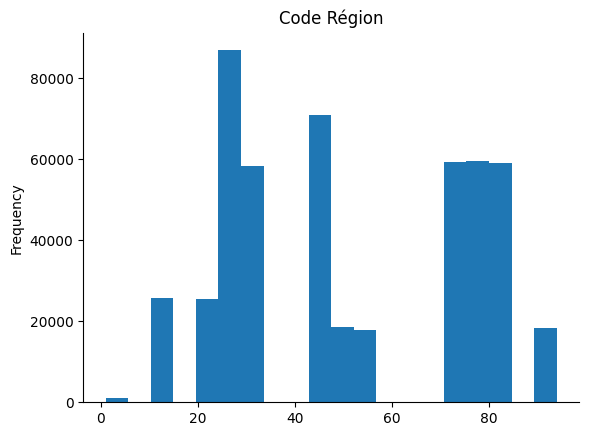

In [238]:
from matplotlib import pyplot as plt
df['Code Région'].plot(kind='hist', bins=20, title='Code Région')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [239]:
df

,Opérateur,Année,Filière,Consommation Agriculture (MWh),Nombre de points Agriculture,Nombre de mailles secretisées (agriculture),Indique qualité Agriculture,Consommation Industrie (MWh),Nombre de points Industrie,Nombre de mailles secretisées (industrie),...,Libellé Commune,Code EPCI,Libellé EPCI,Code Département,Libellé Département,Code Région,Libellé Région,id_filiere,Consommation totale (MWh),Code_postal
0,GRDF,2021,Gaz,0.00,0,0,0.000,0.00000,0,1,...,Armeau,248900334,CA du Grand Sénonais,89,Yonne,27,Bourgogne-Franche-Comté,200,2317.51553,89500
1,GRDF,2021,Gaz,0.00,0,0,0.000,0.00000,0,1,...,Branches,200067114,CA de l'Auxerrois,89,Yonne,27,Bourgogne-Franche-Comté,200,1905.29787,89113
2,GRDF,2021,Gaz,0.00,0,0,0.000,1895.35634,9,0,...,Brienon-sur-Armançon,200067304,CC Serein et Armance,89,Yonne,27,Bourgogne-Franche-Comté,200,16756.07274,89210/89210
3,GRDF,2021,Gaz,0.00,0,0,0.000,0.00000,0,0,...,Brion,248900938,CC du Jovinien,89,Yonne,27,Bourgogne-Franche-Comté,200,1696.15670,89400
4,GRDF,2021,Gaz,0.00,0,1,0.000,0.00000,0,0,...,La Celle-Saint-Cyr,248900938,CC du Jovinien,89,Yonne,27,Bourgogne-Franche-Comté,200,4395.90677,89116
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
501560,Enedis,2012,Electricité,98.36,3,0,1.000,0.00000,0,0,...,Sarcé,200073112,CC Sud Sarthe,72,Sarthe,52,Pays de la Loire,100,1704.74000,72360
501561,Enedis,2012,Electricité,18.05,1,0,1.000,11769.80000,5,0,...,Savigné-l'Évêque,200072684,CC Le Gesnois Bilurien,72,Sarthe,52,Pays de la Loire,100,28685.50000,72460
501562,Enedis,2012,Electricité,0.00,0,0,0.000,1141.88000,1,0,...,Ségrie,200072700,CC Haute Sarthe Alpes Mancelles,72,Sarthe,52,Pays de la Loire,100,3786.45000,72170
501563,Enedis,2012,Electricité,256.28,4,0,0.971,0.00000,0,0,...,Sillé-le-Philippe,200072684,CC Le Gesnois Bilurien,72,Sarthe,52,Pays de la Loire,100,4961.31000,72460


In [240]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 501565 entries, 0 to 501564
Data columns (total 36 columns):
 #   Column                                           Non-Null Count   Dtype  
---  ------                                           --------------   -----  
 0   Opérateur                                        501565 non-null  object 
 1   Année                                            501565 non-null  int64  
 2   Filière                                          501565 non-null  object 
 3   Consommation Agriculture (MWh)                   501565 non-null  float64
 4   Nombre de points Agriculture                     501565 non-null  int64  
 5   Nombre de mailles secretisées (agriculture)      501565 non-null  int64  
 6   Indique qualité Agriculture                      501565 non-null  float64
 7   Consommation Industrie (MWh)                     501565 non-null  float64
 8   Nombre de points Industrie                       501565 non-null  int64  
 9   Nombre de maill

In [241]:
df.describe()

,Année,Consommation Agriculture (MWh),Nombre de points Agriculture,Nombre de mailles secretisées (agriculture),Indique qualité Agriculture,Consommation Industrie (MWh),Nombre de points Industrie,Nombre de mailles secretisées (industrie),Indice qualité Industrie,Consommation Tertiaire (MWh),...,Indice qualité Résidentiel,Thermosensibilité (MWh/degré-jour),Part Thermosensible,Consommation Secteur Inconnu (MWh),Nombre de points Secteur Inconnu,Nombre de mailles secretisées (secteur inconnu),Indice qualité Non Affecté,Code Région,id_filiere,Consommation totale (MWh)
count,501565.000000,501565.000000,501565.000000,501565.000000,501565.000000,5.015650e+05,501565.000000,501565.000000,501565.000000,5.015650e+05,...,501565.000000,501565.000000,501565.000000,501565.000000,501565.000000,501565.000000,501565.000000,501565.000000,501565.000000,5.015650e+05
mean,2016.082165,161.805173,2.618428,0.153119,0.270083,7.481159e+03,4.782919,0.190863,0.403943,4.074937e+03,...,0.385397,0.303469,1.981924,224.122256,10.374857,0.195167,0.092181,51.504375,122.789270,1.957967e+04
std,3.142137,1305.550517,9.991600,0.554474,0.404426,1.176153e+05,31.711106,0.905484,0.458552,2.912693e+04,...,0.327225,2.747896,7.303988,4377.090029,338.538923,0.899366,0.323215,24.620810,41.947344,1.352132e+05
min,2011.000000,-7.390000,0.000000,0.000000,0.000000,-4.000000e+00,0.000000,0.000000,0.000000,0.000000e+00,...,0.000000,0.000000,0.000000,-2.000000,0.000000,0.000000,0.000000,1.000000,100.000000,-6.240000e+02
25%,2013.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000e+00,...,0.253000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,28.000000,100.000000,1.023290e+03
50%,2016.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,1.483543e+02,...,0.386000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,44.000000,100.000000,2.727000e+03
75%,2019.000000,68.501373,1.000000,0.000000,0.719000,5.584100e+02,2.000000,0.000000,0.943000,1.195000e+03,...,0.495000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,76.000000,100.000000,9.297260e+03
max,2021.000000,117864.536000,3819.000000,43.000000,1.000000,1.580105e+07,13629.000000,52.000000,4.000000,7.136445e+06,...,100.000000,443.913000,85.900000,529404.000000,92114.000000,114.000000,100.000000,94.000000,200.000000,1.652888e+07


In [242]:
# Vérifier les valeurs manquantes
print(df.isnull().sum())

Opérateur                                            0
Année                                                0
Filière                                              0
Consommation Agriculture (MWh)                       0
Nombre de points Agriculture                         0
Nombre de mailles secretisées (agriculture)          0
Indique qualité Agriculture                          0
Consommation Industrie (MWh)                         0
Nombre de points Industrie                           0
Nombre de mailles secretisées (industrie)            0
Indice qualité Industrie                             0
Consommation Tertiaire  (MWh)                        0
Nombre de points Tertiaire                           0
Nombre de mailles secretisées (tertiaire)            0
Indice qualité Tertiaire                             0
Consommation Résidentiel  (MWh)                      0
Nombre de points Résidentiel                         0
Nombre de mailles secretisées (résidentiel)          0
Indice qua

In [243]:
# Remplacer les valeurs manquantes par 0 dans les colonnes de consommation
cols_to_fill = ['Consommation Agriculture (MWh)', 'Consommation Industrie (MWh)',
                'Consommation Tertiaire  (MWh)', 'Consommation Résidentiel  (MWh)',
                'Consommation totale (MWh)']
df[cols_to_fill] = df[cols_to_fill].fillna(0)

In [244]:
total_consumption_by_sector = df.groupby('Filière').agg({
       'Consommation totale (MWh)': 'sum'
   }).reset_index()

print(total_consumption_by_sector)

       Filière  Consommation totale (MWh)
0  Electricité               4.683306e+09
1          Gaz               5.137173e+09


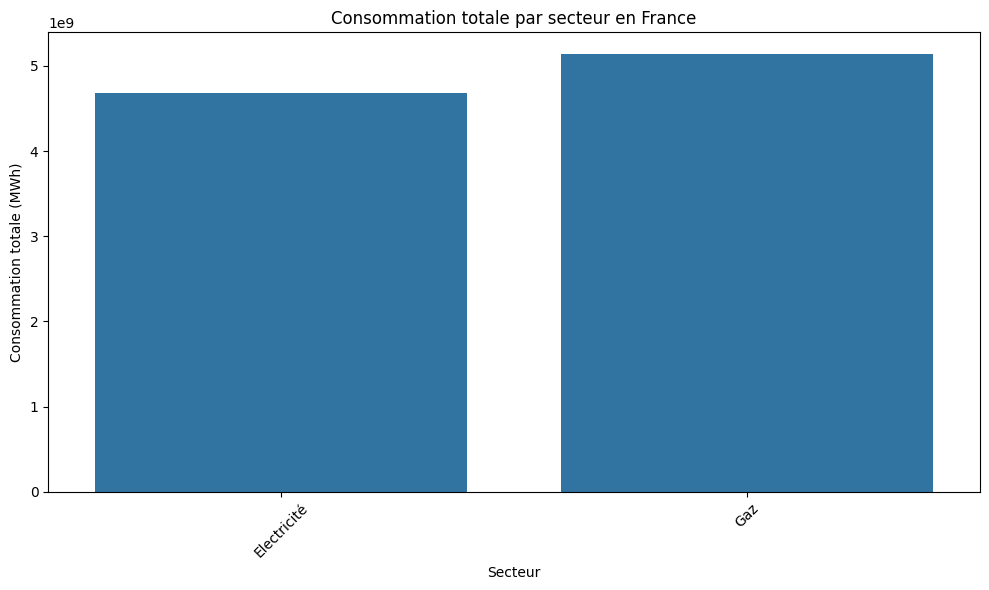

In [245]:
plt.figure(figsize=(10, 6))
sns.barplot(x='Filière', y='Consommation totale (MWh)', data=total_consumption_by_sector)
plt.title('Consommation totale par secteur en France')
plt.xlabel('Secteur')
plt.ylabel('Consommation totale (MWh)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [246]:
total_consumption_by_sector = df.groupby('Filière').agg({
       'Consommation totale (MWh)': 'sum'
   }).reset_index()

fig = px.bar(total_consumption_by_sector,
            x='Filière',
            y='Consommation totale (MWh)',
            title='Consommation totale par secteur en France',
            labels={'Filière': 'Secteur', 'Consommation totale (MWh)': 'Consommation totale (MWh)'})
fig.update_layout(xaxis_title='Secteur', yaxis_title='Consommation totale (MWh)', xaxis_tickangle=-45)
fig.show()

In [247]:
consumption_by_region = df.groupby('Libellé Région').agg({
       'Consommation totale (MWh)': 'sum'
   }).reset_index()

fig_region = px.bar(consumption_by_region,
                    x='Libellé Région',
                    y='Consommation totale (MWh)',
                    title='Consommation totale par région en France',
                    labels={'Libellé Région': 'Région', 'Consommation totale (MWh)': 'Consommation totale (MWh)'})
fig_region.update_layout(xaxis_title='Région', yaxis_title='Consommation totale (MWh)', xaxis_tickangle=-45)
fig_region.show()

In [248]:
fig_thermo = px.scatter(df,
                           x='Thermosensibilité (MWh/degré-jour)',
                           y='Consommation totale (MWh)',
                           title='Impact de la thermosensibilité sur la consommation totale',
                           labels={'Thermosensibilité (MWh/degré-jour)': 'Thermosensibilité (MWh/degré-jour)',
                                   'Consommation totale (MWh)': 'Consommation totale (MWh)'})
fig_thermo.update_layout(xaxis_title='Thermosensibilité (MWh/degré-jour)', yaxis_title='Consommation totale (MWh)')
fig_thermo.show()

In [249]:
fig_thermo = px.scatter(df,
                           x='Thermosensibilité (MWh/degré-jour)',
                           y='Consommation totale (MWh)',
                           title='Impact de la thermosensibilité sur la consommation totale',
                           labels={'Thermosensibilité (MWh/degré-jour)': 'Thermosensibilité (MWh/degré-jour)',
                                   'Consommation totale (MWh)': 'Consommation totale (MWh)'})
fig_thermo.update_layout(xaxis_title='Thermosensibilité (MWh/degré-jour)', yaxis_title='Consommation totale (MWh)')
fig_thermo.show()

In [250]:
consumption_by_region = df.groupby('Libellé Région').agg({
       'Consommation totale (MWh)': 'sum'
   }).reset_index()

# Exclure les lignes avec des valeurs nulles pour 'Libellé Région' ou 'Consommation totale (MWh)'
consumption_by_region = consumption_by_region.dropna()

fig_region = px.bar(consumption_by_region,
                    x='Libellé Région',
                    y='Consommation totale (MWh)',
                    title='Consommation totale par région en France',
                    labels={'Libellé Région': 'Région', 'Consommation totale (MWh)': 'Consommation totale (MWh)'})
fig_region.update_layout(xaxis_title='Région', yaxis_title='Consommation totale (MWh)', xaxis_tickangle=-45)
fig_region.show()

In [251]:
# Filtrer pour exclure les lignes avec des valeurs nulles
df_filtered = df.dropna(subset=['Thermosensibilité (MWh/degré-jour)', 'Consommation totale (MWh)'])

fig_thermo = px.scatter(df_filtered,
                        x='Thermosensibilité (MWh/degré-jour)',
                        y='Consommation totale (MWh)',
                        title='Impact de la thermosensibilité sur la consommation totale',
                        labels={'Thermosensibilité (MWh/degré-jour)': 'Thermosensibilité (MWh/degré-jour)',
                                'Consommation totale (MWh)': 'Consommation totale (MWh)'})
fig_thermo.update_layout(xaxis_title='Thermosensibilité (MWh/degré-jour)', yaxis_title='Consommation totale (MWh)')
fig_thermo.show()

In [252]:
df_conso.columns

Index(['OPERATEUR', 'FILIERE', 'Année', 'code region', 'Nom Région',
       'CODE CATEGORIE CONSOMMATION', 'CODE GRAND SECTEUR',
       'CODE SECTEUR NAF2', 'Nb sites', 'Conso totale (MWh)',
       'Conso moyenne (MWh)', 'Nombre de mailles secretisées'],
      dtype='object')

In [253]:
# Filtrer les colonnes contenant le mot 'depenses'
depenses_columns = [col for col in df_depenses.columns if 'depenses' in col]

# Vérifier si des colonnes ont été trouvées
if not depenses_columns:
    raise ValueError("Aucune colonne contenant 'depenses' n'a été trouvée dans df_depenses.")

# Convertir les colonnes de dépenses en numériques
df_depenses[depenses_columns] = df_depenses[depenses_columns].apply(pd.to_numeric, errors='coerce')

# Vérifier si toutes les colonnes sont nulles pour une ligne donnée
if df_depenses[depenses_columns].isnull().all(axis=1).any():
    print("Attention : Certaines lignes n'ont aucune valeur valide dans les colonnes de dépenses.")

# Calculer les dépenses totales
df_depenses['total_depenses'] = df_depenses[depenses_columns].sum(axis=1)

# Afficher un aperçu pour vérifier
print(df_depenses[['total_depenses'] + depenses_columns].head())


   total_depenses  depenses 2023  depenses 2022  depenses 2021  depenses 2020  \
0         1132.52          154.8          137.8           98.3           98.3   
1          456.26           39.7           47.2           44.8           36.4   
2          596.00           59.3           69.4           64.9           52.3   
3          315.69           39.0           35.5           37.1           27.0   
4           62.21            8.0            5.8            6.6            6.9   

   depenses 2019  depenses 2018  depenses 2017  depenses 2016  depenses 2015  \
0          113.8           82.3          78.45          73.10           83.2   
1           53.3           41.2          41.43          29.32           39.3   
2           60.2           46.1          51.00          38.07           41.0   
3           39.7           27.2          20.48          17.95           24.8   
4            5.6            5.4           4.26           3.94            3.8   

   depenses 2014  depenses 2013 

In [254]:
# Fusionner les DataFrames sur le code région

df = df.rename(columns={'Code Région': 'code region'})

df_merged = df_depenses.merge(df, on='code region', how='inner')

# Vérifiez que les colonnes correspondent

In [255]:
df_merged.columns

Index(['code region', 'Nom de la Region', 'depenses 2023',
       'nombre travaux 2023', 'depenses 2022', 'nombre travaux 2022',
       'depenses 2021', 'depenses 2020', 'depenses 2019', 'depenses 2018',
       'depenses 2017', 'depenses 2016', 'depenses 2015', 'depenses 2014',
       'depenses 2013', 'depenses 2012', 'depenses 2011', 'total_depenses',
       'Opérateur', 'Année', 'Filière', 'Consommation Agriculture (MWh)',
       'Nombre de points Agriculture',
       'Nombre de mailles secretisées (agriculture)',
       'Indique qualité Agriculture', 'Consommation Industrie (MWh)',
       'Nombre de points Industrie',
       'Nombre de mailles secretisées (industrie)', 'Indice qualité Industrie',
       'Consommation Tertiaire  (MWh)', 'Nombre de points Tertiaire',
       'Nombre de mailles secretisées (tertiaire)', 'Indice qualité Tertiaire',
       'Consommation Résidentiel  (MWh)', 'Nombre de points Résidentiel',
       'Nombre de mailles secretisées (résidentiel)',
       'Indic

In [256]:
df_merged

,code region,Nom de la Region,depenses 2023,nombre travaux 2023,depenses 2022,nombre travaux 2022,depenses 2021,depenses 2020,depenses 2019,depenses 2018,...,Code Commune,Libellé Commune,Code EPCI,Libellé EPCI,Code Département,Libellé Département,Libellé Région,id_filiere,Consommation totale (MWh),Code_postal
0,84.0,Auvergne-Rhône-Alpes,154.8,16021,137.8,114.4,98.3,98.3,113.8,82.3,...,38001,Les Abrets en Dauphiné,200068567,CC Les Vals du Dauphiné,38,Isère,Auvergne-Rhône-Alpes,200,1314.00,38490/38490/38490
1,84.0,Auvergne-Rhône-Alpes,154.8,16021,137.8,114.4,98.3,98.3,113.8,82.3,...,38005,Allemond,243800745,CC de l'Oisans,38,Isère,Auvergne-Rhône-Alpes,200,973.00,38114
2,84.0,Auvergne-Rhône-Alpes,154.8,16021,137.8,114.4,98.3,98.3,113.8,82.3,...,38050,Le Bouchage,200068542,CC Les Balcons du Dauphiné,38,Isère,Auvergne-Rhône-Alpes,200,82.00,38510
3,84.0,Auvergne-Rhône-Alpes,154.8,16021,137.8,114.4,98.3,98.3,113.8,82.3,...,38082,Charavines,243800984,CA du Pays Voironnais,38,Isère,Auvergne-Rhône-Alpes,200,49820.00,38850
4,84.0,Auvergne-Rhône-Alpes,154.8,16021,137.8,114.4,98.3,98.3,113.8,82.3,...,38162,Faverges-de-la-Tour,200068567,CC Les Vals du Dauphiné,38,Isère,Auvergne-Rhône-Alpes,200,467.00,38110
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
500332,93.0,PROVENCE-ALPES-CÔTE D'AZUR,71.4,6400,59.0,4277.0,55.4,38.6,41.5,30.9,...,13207,Marseille 7e Arrondissement,200054807,Métropole d'Aix-Marseille-Provence,13,Bouches-du-Rhône,Provence-Alpes-Côte d'Azur,100,140475.94,13007
500333,93.0,PROVENCE-ALPES-CÔTE D'AZUR,71.4,6400,59.0,4277.0,55.4,38.6,41.5,30.9,...,13210,Marseille 10e Arrondissement,200054807,Métropole d'Aix-Marseille-Provence,13,Bouches-du-Rhône,Provence-Alpes-Côte d'Azur,100,190829.64,13010
500334,93.0,PROVENCE-ALPES-CÔTE D'AZUR,71.4,6400,59.0,4277.0,55.4,38.6,41.5,30.9,...,13211,Marseille 11e Arrondissement,200054807,Métropole d'Aix-Marseille-Provence,13,Bouches-du-Rhône,Provence-Alpes-Côte d'Azur,100,301021.88,13011/13011
500335,93.0,PROVENCE-ALPES-CÔTE D'AZUR,71.4,6400,59.0,4277.0,55.4,38.6,41.5,30.9,...,13215,Marseille 15e Arrondissement,200054807,Métropole d'Aix-Marseille-Provence,13,Bouches-du-Rhône,Provence-Alpes-Côte d'Azur,100,252444.74,13015


In [257]:
correlation = df_merged['total_depenses'].corr(df_merged['Consommation Résidentiel  (MWh)'])
print(f"Coefficient de corrélation entre total des dépenses et consommation résidentielle : {correlation}")

Coefficient de corrélation entre total des dépenses et consommation résidentielle : 0.05706747663165287


In [258]:
import plotly.express as px

# Visualisation
fig = px.scatter(df_merged,
                 x='total_depenses',
                 y='Consommation Résidentiel  (MWh)',
                 color='Nom de la Region',
                 title='Relation entre Dépenses Totales et Consommation Résidentielle',
                 labels={'total_depenses': 'Dépenses Totales (EUR)',
                         'Consommation (MWh)': 'Consommation Résidentielle (MWh)'})

# Afficher la figure
fig.show()

In [259]:
import pandas as pd

# Charger le fichier
file_path_1 = "/content/conso-elec-gaz-annuelle-par-secteur-dactivite-agregee-commune.csv"
df_consommation = pd.read_csv(file_path_1, delimiter=';')

# Afficher les premières lignes du DataFrame
print(df_consommation.head())

# Définir les colonnes inutiles à supprimer
columns_to_drop = [
  'Nombre de points Agriculture'
  'Nombre de mailles secretisées (agriculture)',
  'Indique qualité Agriculture',
  'Consommation Industrie (MWh)',
  'Consommation Agriculture (MWh)',
  'Nombre de points Industrie',
  'Nombre de mailles secretisées (industrie)',
  'Indice qualité Industrie',
  'Consommation Tertiaire  (MWh)',
  'Nombre de points Tertiaire',
  'Nombre de mailles secretisées (tertiaire)',
  'Indice qualité Tertiaire',
  'Nombre de mailles secretisées (résidentiel)',
  'Part Thermosensible',
  'Consommation Secteur Inconnu (MWh)',
  'Nombre de points Secteur Inconnu',
  'Nombre de mailles secretisées (secteur inconnu)',
  'Indice qualité Non Affecté',
  'Libellé Commune	Code EPCI',
  'Libellé EPCI',
  'id_filiere',
  'Consommation totale (MWh)'
]

# Appliquer la pipeline de nettoyage
pipeline_consommation = create_cleaning_pipeline(
    columns_to_drop=columns_to_drop,
    missing_value_strategy='mean',
    outlier_threshold=1.5
)

# Nettoyer le DataFrame
df_consommation_cleaned = pipeline_consommation.fit_transform(
    df_consommation.select_dtypes(include=['float64', 'int64'])
)

# Ajouter les colonnes non numériques nettoyées (si besoin)
df_consommation_cleaned = pd.concat(
    [df_consommation_cleaned, df_consommation.select_dtypes(exclude=['float64', 'int64'])],
    axis=1
)

# Afficher le DataFrame nettoyé
print("\nDataFrame consommation nettoyé :")
print(df_consommation_cleaned.head())

<ipython-input-259-934c8a215769>:5: DtypeWarning:

Columns (25,27,29) have mixed types. Specify dtype option on import or set low_memory=False.



  Opérateur  Année Filière  Consommation Agriculture (MWh)  \
0      GRDF   2021     Gaz                             0.0   
1      GRDF   2021     Gaz                             0.0   
2      GRDF   2021     Gaz                             0.0   
3      GRDF   2021     Gaz                             0.0   
4      GRDF   2021     Gaz                             0.0   

   Nombre de points Agriculture  Nombre de mailles secretisées (agriculture)  \
0                             0                                            0   
1                             0                                            0   
2                             0                                            0   
3                             0                                            0   
4                             0                                            1   

   Indique qualité Agriculture  Consommation Industrie (MWh)  \
0                          0.0                       0.00000   
1                 

In [263]:
df_consommation_cleaned.columns

Index(['année', 'consommation_agriculture_(mwh)',
       'nombre_de_points_agriculture',
       'nombre_de_mailles_secretisées_(agriculture)',
       'indique_qualité_agriculture', 'consommation_industrie_(mwh)',
       'nombre_de_points_industrie',
       'nombre_de_mailles_secretisées_(industrie)', 'indice_qualité_industrie',
       'consommation_tertiaire__(mwh)', 'nombre_de_points_tertiaire',
       'nombre_de_mailles_secretisées_(tertiaire)', 'indice_qualité_tertiaire',
       'consommation_résidentiel__(mwh)', 'nombre_de_points_résidentiel',
       'nombre_de_mailles_secretisées_(résidentiel)',
       'indice_qualité_résidentiel', 'thermosensibilité_(mwh/degré-jour)',
       'part_thermosensible', 'consommation_secteur_inconnu_(mwh)',
       'nombre_de_points_secteur_inconnu',
       'nombre_de_mailles_secretisées_(secteur_inconnu)',
       'indice_qualité_non_affecté', 'code_région',
       'consommation_totale_(mwh)', 'Opérateur', 'Filière', 'Code Commune',
       'Libellé Comm

In [260]:
# Charger le fichier
file_path_2 = "/content/depenses_region_anah.csv"
df_depenses = pd.read_csv(file_path_2)

# Définir les colonnes inutiles à supprimer
columns_to_drop = []

# Appliquer la pipeline de nettoyage
pipeline_depenses = create_cleaning_pipeline(
    columns_to_drop=columns_to_drop,
    missing_value_strategy='mean',
    outlier_threshold=1.5
)

# Nettoyer le DataFrame
df_depenses_cleaned = pipeline_depenses.fit_transform(
    df_depenses.select_dtypes(include=['float64', 'int64'])
)

# Ajouter les colonnes non numériques nettoyées (si besoin)
df_depenses_cleaned = pd.concat(
    [df_depenses_cleaned, df_depenses.select_dtypes(exclude=['float64', 'int64'])],
    axis=1
)

# Afficher le DataFrame nettoyé
print("\nDataFrame dépenses nettoyé :")
print(df_depenses_cleaned.head())



DataFrame dépenses nettoyé :
   code_region  depenses_2023  nombre_travaux_2023  depenses_2022  \
0         84.0          154.8              16021.0          137.8   
1         27.0           39.7               3824.0           47.2   
2         53.0           59.3               5304.0           69.4   
3         24.0           39.0               4300.0           35.5   
4         94.0            8.0                500.0            5.8   

   nombre_travaux_2022  depenses_2021  depenses_2020  depenses_2019  \
0                114.4           98.3           98.3          113.8   
1               4284.0           44.8           36.4           53.3   
2               6736.0           64.9           52.3           60.2   
3               4238.0           37.1           27.0           39.7   
4                402.0            6.6            6.9            5.6   

   depenses_2018  depenses_2017  depenses_2016  depenses_2015  depenses_2014  \
0           82.3          78.45          73.10  

In [264]:
df_depenses_cleaned.columns

Index(['code_region', 'depenses_2023', 'nombre_travaux_2023', 'depenses_2022',
       'nombre_travaux_2022', 'depenses_2021', 'depenses_2020',
       'depenses_2019', 'depenses_2018', 'depenses_2017', 'depenses_2016',
       'depenses_2015', 'depenses_2014', 'depenses_2013', 'depenses_2012',
       'depenses_2011', 'Nom de la Region'],
      dtype='object')

In [275]:
# import pandas as pd
# import seaborn as sns
# import matplotlib.pyplot as plt
# from sklearn.linear_model import LinearRegression
# from sklearn.metrics import r2_score


# # Nettoyer les colonnes et transformer en numérique
# depense_columns = [col for col in df_depenses_clean.columns if 'depenses' in col]
# df_depenses_clean[depense_columns] = df_depenses_clean[depense_columns].apply(pd.to_numeric, errors='coerce')
# df_consommation_cleaned['consommation_résidentiel__(mwh)'] = pd.to_numeric(df_consommation_cleaned['consommation_résidentiel__(mwh)'], errors='coerce')

# # Fusionner les deux datasets sur la colonne "Code Région"
# df_merged = pd.merge(df_consommation_cleaned, df_depenses_clean, left_on='code_région', right_on='code_region', how='inner')

# # Ajouter une colonne de dépenses totales (investissements cumulés sur les années)
# df_merged['Depenses totales'] = df_merged[depense_columns].sum(axis=1)

# # Retirer les lignes avec des valeurs manquantes
# df_merged = df_merged.dropna(subset=['Depenses totales', 'Consommation totale (MWh)'])

# # Analyse de corrélation
# correlation = df_merged['Depenses totales'].corr(df_merged['Consommation totale (MWh)'])
# print(f"Corrélation entre les dépenses et la consommation : {correlation:.2f}")

# # Régression linéaire simple
# X = df_merged[['Depenses totales']]
# y = df_merged['Consommation totale (MWh)']
# model = LinearRegression()
# model.fit(X, y)

# # Prédictions et R²
# y_pred = model.predict(X)
# r2 = r2_score(y, y_pred)
# print(f"R² de la régression linéaire : {r2:.2f}")

# # Visualisation
# plt.figure(figsize=(10, 6))
# sns.scatterplot(x='Depenses totales', y='Consommation totale (MWh)', data=df_merged, label='Données réelles')
# plt.plot(df_merged['Depenses totales'], y_pred, color='red', label='Régression linéaire')
# plt.title("Lien entre les dépenses en rénovation et la consommation énergétique")
# plt.xlabel("Dépenses totales en rénovation énergétique (€)")
# plt.ylabel("Consommation totale (MWh)")
# plt.legend()
# plt.show()
